In [22]:
# Python notebook to study the effects of improper BBoxes fed to NEMO classifier

import time, os, sys, warnings
import os.path as osp
import numpy as np
import sklearn

%matplotlib inline
from pylab import *
import pydot
import matplotlib.patches as patches

import caffe
import pynemo
from PIL import ImageDraw, Image
import csv
from caffe import layers as L, params as P
from caffe.proto import caffe_pb2
import caffe.draw

from IPython.display import Image, display

import cv2
from PIL import Image
# from easydict import EasyDict as edict
# from easydict import EasyDict

caffe.set_device(1)
caffe.set_mode_gpu()

In [23]:
# get the data loader here

# Helper functions for loading data

def get_cord(txt_loc):
    cord = []
    with open(txt_loc, 'r') as f:
        reader = csv.reader(f, dialect='excel', delimiter='\t')		
        cord_arr = np.zeros(4) 
        for row in reader:
            """
            The below stuff is required if the a$$nuckle who created the bboxes txt file didn't tab delimit 
            but instead used spaces
            """
            if (len(row) == 1):
                row = row[0].split()
            img_class = row[0]
            cord.append(row[0])
            cord_arr[0] = float(row[4])
            cord_arr[1] = float(row[5])
            cord_arr[2] = float(row[6])
            cord_arr[3] = float(row[7])
            cord.append(cord_arr)
            cord_arr = np.zeros(4)
    f.close()
    return cord

def data_loader(path, mode, return_img = False):
    """
    Function to load image locations, corresponding classes and BBoxes contained withing a list file

    return:
    A list with each individual image of the form
    [Image_location in str, Image_Class, BBox in []]
    """
    # Reference the directory of the GVDL folder
    img_loc = path + mode + '.list'
    data = [] 
    with open(img_loc, 'r') as f:
        reader = csv.reader(f, dialect='excel', delimiter='\t')		
        for row in reader:
            # seperate test-case for COCO
            if (path[-5:-1] == 'COCO'):   
                text = row[0][0:5] + '-labels/' + row[0][-16:-3] + 'txt'
            # for VOC and GVDL-D
            else:
                if (mode == 'test'):
                    text = row[0][0:5] + 'labels'+ row[0][11:-3] + 'txt' 
                if (mode == 'validation'):
#                     print(row[0])
#                     print(row[0][0:11]+ 'labels'+ row[0][15:-3])
                    text = row[0][0:11] + 'labels'+ row[0][17:-3] + 'txt' 
                if (mode == 'train'):
#                     print(row[0])
#                     print(row[0][0:6]+ 'labels'+ row[0][12:-3])
                    text = row[0][0:6] + 'labels' + row[0][12:-3] + 'txt'
            cord = get_cord(path + text)
#             print(cord[1])
            img = Image.open(path + row[0])
            if (len(np.shape(img))!=3):
                img = np.asarray(img)
                img = np.repeat(img[:, :, np.newaxis], 3, axis=2)
#             print(np.shape(img))
            cord[1] = normalized_cord(img,cord[1])
#             print(cord[1])
            if (return_img == False):
                data.append([path + row[0], cord])
            else:
#                 print("Demanding images")
                data.append([Image.open(path + row[0]), cord])
                
    """ The following code is to verify the dataloader 
        Please give the index of the image file you want to load; the code will take care of the txt file
        To verify, give a particular index
    """
#     print(len(data))
    return data

def normalized_cord(image, cord):
#     function to normalize the cordinates
    y, x,_ = np.shape(image)
    x_top, y_top, x_bottom, y_bottom = cord
    return x_top/x, y_top/y, x_bottom/x, y_bottom/y

In [24]:
# To load the GVDL data
data_train = data_loader('/opt/caffe/neurala/training-pipeline/models/FullDenseNet/GVDL-D/', 'train', return_img = False)
data_test = data_loader('/opt/caffe/neurala/training-pipeline/models/FullDenseNet/GVDL-D/', 'validation', return_img = False)
# data_valid = data_loader('/opt/caffe/neurala/training-pipeline/models/FullDenseNet/GVDL-D/', 'validation', return_img = False)

In [25]:
def loadBatch(net, processed_ims):
    
    num_images = len(processed_ims)
    max_shape = np.array([im.shape for im in processed_ims]).max(axis=0)
    
    # Blob placeholder
    blob = np.zeros((num_images, max_shape[0], max_shape[1], 3),dtype=np.float32)

    
    # load images into blob placeholder
    #==================================================
    for i in range(num_images):
        im = processed_ims[i]
#         print(i)
        blob[i, 0:im.shape[0], 0:im.shape[1], :] = im
    

    # Change Channels in Caffe format
    #==================================================
    channel_swap = (0, 3, 1, 2)   # Original    
    blob = blob.transpose(channel_swap)


#     im_scales = np.array(im_scale_factors)

    blobs = {'data' : None}
    blobs['data'] = blob
    im_blob = blobs['data']
    # reshape network inputs
    net.blobs['data'].reshape(*(blobs['data'].shape))
    return {'data': blobs['data'].astype(np.float32, copy=False)}

In [26]:
def forward(img, cord):
#     print(cord)
    net =  caffe.Net('/opt/caffe/neurala/training-pipeline/models/classifier/complete_model/GorchNet-512.prototxt',
                     '/opt/caffe/neurala/training-pipeline/models/classifier/complete_model/GorchNet-512.caffemodel',
                     caffe.TEST)
    blobs_out = net.forward(**loadBatch(net,[img]))
#     print(np.shape(img))
#     out = loadBatch(net,img)
    mydata = net.blobs['cascade192/output'].data
#     index = 0
#     output = np.squeeze(mydata[0,index,:,:])
#     plt.imshow(output)
    
    
#     must get the labels ready
#     print(np.shape(mydata.tolist()))
#     print(np.shape(cord))
    cord = np.reshape(cord,(1,1,1,5))

#     print(np.shape(cord))
    net3 = caffe.Net('/opt/caffe/neurala/training-pipeline/models/classifier/complete_model/complete_model_gorchnet.prototxt',
                     '/opt/caffe/neurala/training-pipeline/models/classifier/complete_model/GorchNet-ROI.caffemodel',
                    caffe.TEST)
    net3.blobs['data'].data[...] = mydata.tolist()
    net3.blobs['bboxes'].data[...] = cord.tolist()
    class_output = net3.forward()
    out =  net3.blobs['global_pool'].data
    roi = net3.blobs['roi_pool'].data
#     print(np.shape(net3.blobs['roi_pool'].data[...]))
#     print(np.shape(out))
    return out

In [27]:
# Following fucntion comes with Image visualization; for main purpose use the scale_cord function
def update_cord(cord_arr,scale = 1):
    #  function to display the image being passed to the network 
    x_top, y_top, x_bottom, y_bottom = cord_arr[1:]
    img_dim = 1
    center = np.array([(x_top + x_bottom)/2, (y_top + y_bottom)/2])
    dims = np.array([x_bottom-center[0],y_bottom-center[1]])
    x_center, y_center = center[0], center[1]
    x_top = x_center-dims[0]*scale
    if (x_top < 0):
        x_top = 0
    y_top = y_center-dims[1]*scale
    if (y_top < 0):
        y_top = 0
    x_bottom = x_center+dims[0]*scale
    if (x_bottom > img_dim):
        x_bottom = img_dim
    y_bottom = y_center+dims[1]*scale
    if (y_bottom > img_dim):
        y_bottom = img_dim
    new_cord = np.array([0,x_top/img_dim, y_top/img_dim, x_bottom/img_dim, y_bottom/img_dim])
    return new_cord

In [28]:
def display_img(img, cord_arr,scale = 1):
#     function to display the image being passed to the network 
    cord_arr = update_cord(cord_arr, scale)
    x_top, y_top, x_bottom, y_bottom = cord_arr[1:]
    x_top, y_top, x_bottom, y_bottom = int(x_top*512), int(y_top*512), int(x_bottom*512), int(y_bottom*512) 
    center = np.array([(x_top + x_bottom)/2, (y_top + y_bottom)/2])
    dims = np.array([x_bottom-center[0],y_bottom-center[1]])
    x_center, y_center = int(center[0]), int(center[1])
#     print("The center of the BBox",x_center, y_center)
#     print("The dimensions are ", dims/2)
#     print("The original cordinates of the BBox",x_top, y_top, x_bottom, y_bottom)
    x_top = int(abs(x_center-dims[0]))
    y_top = int(abs(y_center-dims[1]))
    x_bottom = int(abs(x_center+dims[0]))
    y_bottom = int(abs(y_center+dims[1]))
#     print("The new cordinates of the BBox",x_top, y_top, x_bottom, y_bottom)
    cv2.rectangle(img,(x_top,y_top),(x_bottom,y_bottom),(0,255,0),3)
#     x_top, y_top, x_bottom, y_bottom = x_top * scale, y_top * scale, x_bottom * scale, y_bottom * scale 
    x_top = int(x_center-dims[0]*scale)
#     print(x_center, x_top)
    if (x_top < 0):
        x_top = 0
    y_top = int(y_center-dims[1]*scale)
    if (y_top < 0):
        y_top = 0
    x_bottom = int(x_center+dims[0]*scale)
    if (x_bottom > 512):
        x_bottom = 512
    y_bottom = int(y_center+dims[1]*scale)
    if (y_bottom > 512):
        y_bottom = 512
#     print("The cordinates of the BBox",x_top, y_top, x_bottom, y_bottom)
    cv2.rectangle(img,(int(x_top),int(y_top)),(int(x_bottom),int(y_bottom)),(255,0,0),3)
    fig1,ax1 = plt.subplots(1)
    ax1.imshow(img)
    new_cord = np.array([0,x_top, y_top, x_bottom, y_bottom])
#     plt.imshow(img)
    return new_cord.tolist()

In [29]:
def process_data(data):
    print(len(data))
    img_list = []
    gt_label_list = []
    gt_cord_list = []
    pad = np.zeros((len(data),1))
    for i in range(len(data)):
        img_list.append(data[i][0])
        gt_label_list.append(data[i][1][0])
        gt_cord_list.append(data[i][1][1])
    # print(gt_cord_list)
    gt_cord_arr = np.asarray(gt_cord_list)
    gt_cord_arr = np.hstack((pad, gt_cord_arr))
#     print(gt_cord_arr[0])
    im_batch = img_list   # Pass the batch
    num_images = len(im_batch)
    processed_ims = []
    im_scale_factors = []  #for multiscale processing

    for j,im_file  in enumerate(im_batch):
    #     print(im_file)
        im = cv2.imread(im_file)
        im = cv2.cvtColor(im, cv2.COLOR_RGB2BGR)
#         plt.imshow(im)

        # Retype and normilize image
        #-------------------------------------------
        im_orig = im.astype(np.float32, copy=True)
        im_orig /= 255
        im_orig -= .5


        # Get shape and Max and Min of an image
        #-------------------------------------------
        im_shape = im_orig.shape
    #     print(im_shape)
        im_size_min = np.min(im_shape[0:2])
        im_size_max = np.max(im_shape[0:2])


        target_size = 512
        im_scale = float(target_size) / float(im_size_min)

        #--------------------------------------------------------------
        # Future: multiscale load
        # Prevent the biggest axis from being more than MAX_SIZE
        #if np.round(im_scale * im_size_max) > MAX_SIZE:
        #    im_scale = float(MAX_SIZE) / float(im_size_max)
        #--------------------------------------------------------------
        imW = (im_shape[1])
        imH = (im_shape[0])

        target_size = 512
        im_scaleX = float(target_size) / float(imW)
        im_scaleY = float(target_size) / float(imH)

        im = cv2.resize(im_orig, None, None, fx=im_scaleX, fy=im_scaleY, interpolation=cv2.INTER_LINEAR)

    #     im = cv2.resize(im_orig, None, None, fx=im_scale, fy=im_scale, interpolation=cv2.INTER_LINEAR)
    #     print(im.shape)

        im_scale_factors.append(im_scale)

        processed_ims.append(im)
#     print(np.shape(processed_ims))
    return processed_ims, gt_cord_arr, gt_label_list

In [30]:
# Below is the code for translation
processed_ims, gt_cord_arr, gt_label_list = process_data(data_train)
processed_ims2, gt_cord_arr2, gt_label_list2 = process_data(data_test)

131
159


In [31]:
gt_label_list2
np.save('gt_label_validation', np.asarray(gt_label_list2))

In [32]:
# Code to try out random shuffling of training image
from sklearn.utils import shuffle

# Confirm whether the dimensions are constant across!
def check_dimensions(ims, cords, labels):
    assert (ims == cords == labels), "Dimension are not same"
    return ims
        
size = check_dimensions(len(processed_ims), len(gt_cord_arr), len(gt_label_list))

# The order array keeps track of how the data was shuffled.
order = np.arange(size)

processed_ims, gt_cord_arr, gt_label_list, order = shuffle(processed_ims, gt_cord_arr, gt_label_list, order)

# save the order for later reference
np.save('order_three.npy', order)
print(np.load('order_three.npy'))

[ 96  55  89 122  40 130   1  52  66  50  26   5  49  43 116  79  97  59
  37  72  94 112  24  46 105  90  63  87  77  65 114  95 124  67 128   6
  74  45  85  39  34  16  47  30  11  36  98  99 120  27 127   4  29  69
 103  91  10  57 102  80 121 107   7 109  14  33  44  93 104  35 119  68
 118  23 108  21  70  22  83  48 110  18  75  25  12  92 123  62  73 100
 101  81  58  71  56  31  78  42  32  54 111  19 126 113  41  13  60  53
   8   9   2  61  51 115  76 129  38 106  17 117  64  86  88 125   3  28
  15   0  82  84  20]


In [33]:
# for training 
input_vec = []
for i in range(len(processed_ims)):
    out = forward(processed_ims[i], gt_cord_arr[i])
    input_vec.append(np.reshape(out,(128)))
    
# Train the NEMO classifier here
nemo = pynemo.nemo(dominance= 1.25, m_learningRate=1)
nemo.learn(inputs = np.asarray(input_vec), labels = np.asarray(gt_label_list))

131

In [34]:
# xmin ymin xmax ymax
def IOUCalc(boxes, query_boxes):
    """
    determine overlaps between boxes and query_boxes
    :param boxes: n * 5 bounding boxes (4 + 1 for objectness)
    :param query_boxes: k * 5 bounding boxes (4 + 1 for objectness)
    :return: overlaps: n * k overlaps
    """
    #overlaps = np.zeros((n_, k_), dtype=np.float)
    #for k in range(k_):
    query_box_area = (query_boxes[3] - query_boxes[1] + 1) * (query_boxes[4] - query_boxes[2] + 1)
    #for n in range(n_):
    iw = min(boxes[3], query_boxes[3]) - max(boxes[1], query_boxes[1]) + 1
    if iw < 0:
        return 0
    if iw > 0:
        ih = min(boxes[4], query_boxes[4]) - max(boxes[2], query_boxes[2]) + 1
        if ih < 0:
            return 0
        if ih > 0:
            box_area = (boxes[3] - boxes[1] + 1) * (boxes[4] - boxes[2] + 1)
            all_area = float(box_area + query_box_area - iw * ih)
            overlaps = iw * ih / all_area
        return overlaps

In [35]:
def get_IOU(cord_test, update_arr):
    overlap = np.zeros([len(update_arr)])
    for i in range(len(update_arr)):
        overlap[i] = int(IOUCalc(cord_test*512, update_arr[i]*512)*100)
    return overlap

# The main translation code
def translate(img_test, cord_test):
    shape,_,_ = np.shape(img_test) 
    x_top, y_top, x_bottom, y_bottom = cord_test[1:]-0.2
    # print(cord_test[1:], cord_test[1:] - 0.2)
    update_list = []
    for i in range (0,20):#0,0.4,0.02
        for j in range (0,20):
            top_x = x_top + i/50
            top_y = y_top + j/50 
            bottom_x = x_bottom + i/50
            bottom_y = y_bottom + j/50
            if (top_x < 0):
                top_x = 0
            if (top_y < 0):
                top_y = 0
            if (bottom_x > 1):
                bottom_x = 1
            if (bottom_y > 1): 
                bottom_y = 1
    #         print((bottom_x - top_x)* (bottom_y - top_y))
#             cv2.rectangle(img_test,(int(top_x*512),int(top_y*512)),(int(bottom_x*512),int(bottom_y*512)),(255,0,0),3)
            update_list.append(np.array([0,top_x, top_y, bottom_x, bottom_y]))
#             fig1,ax1 = plt.subplots(1)
#             ax1.imshow(img_test)
    plt.imshow(img_test)
    return np.asarray(update_list)

def plot_hist(overlap):
    fig,ax = plt.subplots(1)
    ax.hist(overlap)
    plt.xlabel('Itersection Over Union (IoU)')
    plt.ylabel('Number of Boxes')
#     plt.title('Distribution of Boxes')

# index = 123    # Change the image here
# img_test = processed_ims2[index]
# cord_test = gt_cord_arr2[index]
# gt_test = gt_label_list2[index]
# update_arr = translate(img_test, cord_test)

In [36]:
def evaluate(test_vec):
    predictions = nemo.predict_proba(test_vec, omit_nothing = False)
#     print(predictions)
    preds = predictions.idxmax(axis=1)
    pred_class = [preds[i] for i in range (len(preds))]
    return pred_class

In [37]:
def Class_IOU(img_test, cord_test, gt_test):
    """

#     display_img(img_test, cord_test)
#     print(gt_test)
    update_arr = translate(img_test, cord_test)
#     for i in range(len(update_arr) - (len(update_arr))-10):
#         display_img(img_test, update_arr[i+50])
#     display_img(img_test, update_arr[50])
#     index = 120
#     display_img(img_test, update_arr[index])
    overlap = get_IOU(cord_test, update_arr)
#     print(overlap)
    input_vec_test = []
    for i in range(len(update_arr)):
        out = forward(img_test, update_arr[i])
        input_vec_test.append(np.reshape(out,(128)))
    pred = evaluate(input_vec_test)
#     for i in range(len(update_arr)):
#         print(pred[i])
#         if (pred[i] == 'Nothing I know'):
#             print("NIK")
    TP = []
    FP = []
    NIK = []
    for i in range(len(overlap)):
    #     print(pred[i], overlap[i], gt_test)
        print(pred[i])

        if (pred[i] == "Nothing I know"):
            NIK.append(overlap[i])
            continue
        if (pred[i] == gt_test):
            TP.append(overlap[i])
        else:
            FP.append(overlap[i])
    unique_IOU = list(set(overlap)) 
#     print(unique_IOU)
#     unique_IOU = sorted(unique_IOU) 
    TP = {x:TP.count(x) for x in sorted(unique_IOU)}  
    FP = {x:FP.count(x) for x in sorted(unique_IOU)}  
    NIK = {x:NIK.count(x) for x in sorted(unique_IOU)}  
#     print(unique_IOU)
   

    TP = list(TP.values())
    FP = list(FP.values())
    NIK = list(NIK.values())
#     print(TP)
#     print(FP)
#     print(NIK)
    distribution = np.zeros([len(unique_IOU),4])

    for i in range(len(unique_IOU)):
        distribution[i,:] = unique_IOU[i], TP[i], FP[i], NIK[i] 
    return distribution
    """
#     print("The true label is ", gt_test)
    update_arr = translate(img_test, cord_test)
    overlap = get_IOU(cord_test, update_arr)
#     print("passed")
    plot_hist(overlap)
    # for testing
    input_vec_test = []
    for i in range(len(update_arr)):
        out = forward(img_test, update_arr[i])
        input_vec_test.append(np.reshape(out,(128)))
    pred = evaluate(input_vec_test)
    TP = []
    FP = []
    NIK = []
    for i in range(len(overlap)):
    #     print(pred[i], overlap[i], gt_test)
    #         print(pred[i])
        if (pred[i] == gt_test):
            TP.append(overlap[i])
        elif (pred[i] == "Nothing I know"):
            NIK.append(overlap[i])
        else:
            FP.append(overlap[i])
    unique_IOU = list(set(overlap)) 
#     print(unique_IOU)
    unique_IOU = sorted(unique_IOU) 
    TP = {x:TP.count(x) for x in sorted(unique_IOU)}  
    FP = {x:FP.count(x) for x in sorted(unique_IOU)}  
    NIK = {x:NIK.count(x) for x in sorted(unique_IOU)}  
#     print(unique_IOU)
#     print(TP)
#     print(FP)
#     print(NIK)
    

    TP = list(TP.values())
    FP = list(FP.values())
    NIK = list(NIK.values())

    # Save the final answer in [IoU, TP, FP, NIK]
    distribution = np.zeros([len(unique_IOU),4])

    for i in range(len(unique_IOU)):
        distribution[i,:] = unique_IOU[i], TP[i], FP[i], NIK[i]  
    return distribution


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


array([[ 35.,   1.,   0.,   0.],
       [ 36.,   1.,   0.,   0.],
       [ 37.,   1.,   0.,   0.],
       [ 38.,   2.,   0.,   0.],
       [ 39.,   2.,   0.,   0.],
       [ 40.,   3.,   0.,   0.],
       [ 41.,   4.,   0.,   0.],
       [ 42.,   4.,   0.,   0.],
       [ 43.,   7.,   0.,   0.],
       [ 44.,   6.,   1.,   0.],
       [ 45.,   6.,   0.,   0.],
       [ 46.,   8.,   2.,   0.],
       [ 47.,   6.,   0.,   0.],
       [ 48.,   9.,   3.,   0.],
       [ 49.,   9.,   1.,   0.],
       [ 50.,   5.,   3.,   0.],
       [ 51.,  14.,   2.,   0.],
       [ 52.,   5.,   3.,   0.],
       [ 53.,  12.,   2.,   0.],
       [ 54.,  13.,   4.,   0.],
       [ 55.,   5.,   3.,   0.],
       [ 56.,  11.,   3.,   0.],
       [ 57.,  11.,   5.,   0.],
       [ 58.,   6.,   2.,   0.],
       [ 59.,  10.,   6.,   0.],
       [ 60.,   9.,   1.,   0.],
       [ 61.,   8.,   6.,   0.],
       [ 62.,  11.,   1.,   0.],
       [ 63.,  11.,   3.,   0.],
       [ 64.,   7.,   1.,   0.],
       [ 6

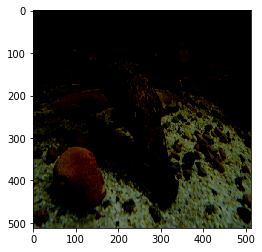

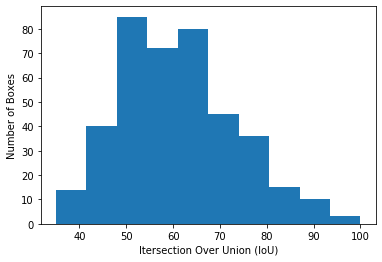

In [38]:
index = 12   # Change the image here
Class_IOU(processed_ims2[index],  gt_cord_arr2[index],  gt_label_list2[index])
# old = Class_IOU(processed_ims2[index],  gt_cord_arr2[index],  gt_label_list2[index]) 
# for i in range(len(new)):
#     print(new[i], old[i])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

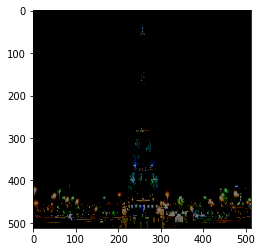

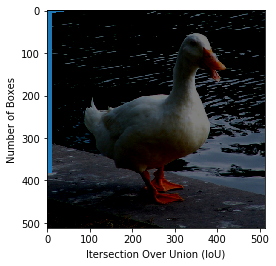

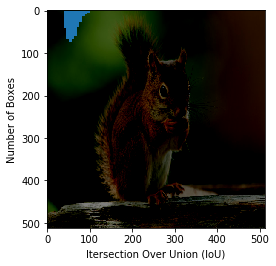

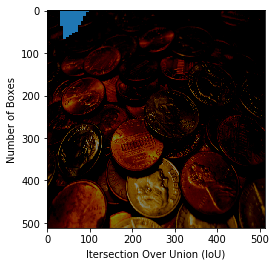

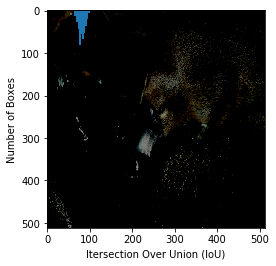

...

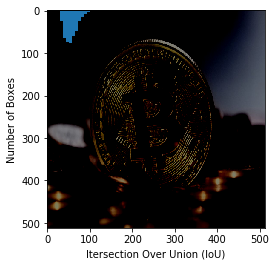

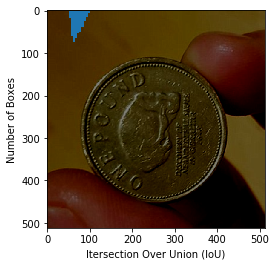

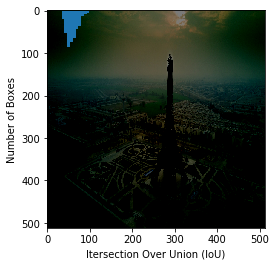

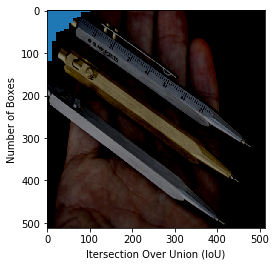

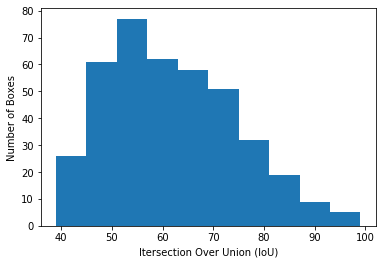

In [39]:
ans = []

# Class_IOU(processed_ims2[index],  gt_cord_arr2[index],  gt_label_list2[index])
# print(len(processed_ims2))
for i in range(len(processed_ims2)):
    ans.append(Class_IOU(processed_ims2[i],  gt_cord_arr2[i],  gt_label_list2[i]))

In [40]:
# np.shape(ans[1])
np.save('translation_three.npy', ans)
a = np.load('translation_three.npy')

# print(a[index])
# print(gt_label_list2[index])

In [21]:
np.save('translation_new.npy', ans)
a = np.load('translation_new.npy')


In [19]:
processed_ims, gt_cord_arr, gt_label_list, order = shuffle(processed_ims, gt_cord_arr, gt_label_list, order)

# save the order for later reference
np.save('order_three.npy', order)
print(np.load('order_three.npy'))

[125  70  90  21 120  43   5  56 127 122  71  77  35   4 118 100  93 124
  49  88  48  59  60  80  34  66 101  81  86 117 126  25 112  96 115  44
 114  85  97 130   3  74  31 119 111  52  82  28   2  64  23 129 106  95
  39   6  58  94  26 123 113  38  51  15   8 103   7  22  18  24  68  37
 102  20  79  65 128  30  12   1  41 121  53 116  10  76 105  46  69  14
  92  63  19  72   9  91  55  98  33  17  67  75  11 104  42  78 110  29
  99  27 109  57  54  47  73  83  40  50  61  45  36  16  32 107  62  84
 108  13   0  89  87]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

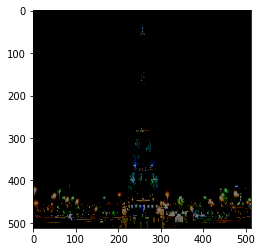

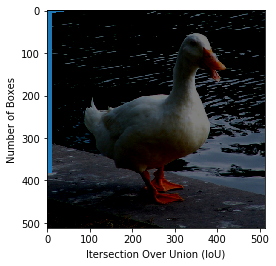

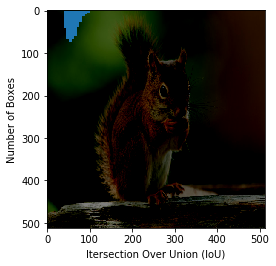

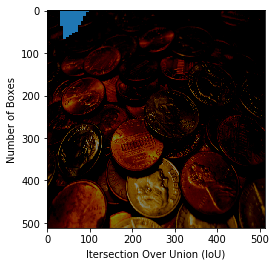

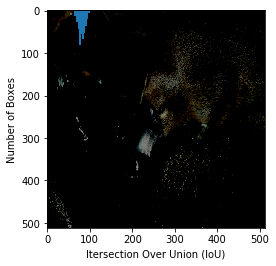

...

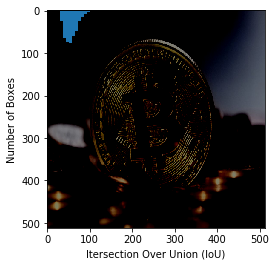

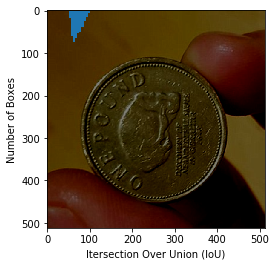

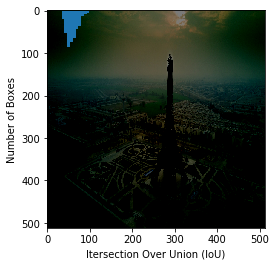

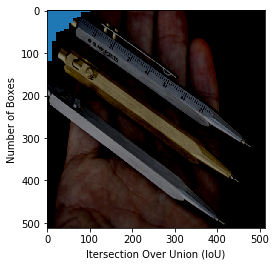

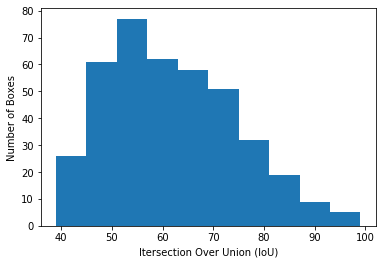

In [20]:
ans = []

# Class_IOU(processed_ims2[index],  gt_cord_arr2[index],  gt_label_list2[index])
# print(len(processed_ims2))
for i in range(len(processed_ims2)):
    ans.append(Class_IOU(processed_ims2[i],  gt_cord_arr2[i],  gt_label_list2[i]))

In [21]:
np.save('translation_three.npy', ans)
a = np.load('translation_three.npy')

In [33]:
# for testing
input_vec_test = []
for i in range(len(update_arr)):
    out = forward(processed_ims2[index], update_arr[i])
    input_vec_test.append(np.reshape(out,(128)))

In [35]:
pred = evaluate(input_vec_test)

In [58]:
def CountFrequency(my_list): 
  
    # Creating an empty dictionary  
    freq = {} 
    for item in my_list: 
        if (item in freq): 
            freq[item] += 1
        else: 
            freq[item] = 1
    return freq

In [113]:
TP = []
FP = []
NIK = []
for i in range(len(overlap)):
#     print(pred[i], overlap[i], gt_test)
    if (pred[i] == gt_test):
        TP.append(overlap[i])
    elif (pred[i] == "Nothing I know"):
        NIK.append(overlap[i])
    else:
        FP.append(overlap[i])
# TP = sorted(TP)
# FP = sorted(FP)
# NIK = sorted(NIK)
# print(TP)
# print(FP)
# print(NIK)
unique_IOU = list(set(overlap)) 
# freq_TP = CountFrequency(TP)
# freq_FP = CountFrequency(FP)
# freq_NIK = CountFrequency(NIK)
freq = IOU_frequency(unique_IOU, freq_TP, freq_FP, freq_NIK)
TP = {x:TP.count(x) for x in sorted(unique_IOU)}  
FP = {x:FP.count(x) for x in sorted(unique_IOU)}  
NIK = {x:NIK.count(x) for x in sorted(unique_IOU)}  
# overall = {x,NIK.count(x) for x in sorted(unique_IOU)}  

TP = list(TP.values())
FP = list(FP.values())
NIK = list(NIK.values())

# print(unique_IOU)
# print(TP)
# print(FP)
# print(NIK)


# Save the final answer in [IoU, TP, FP, NIK]
distribution = np.zeros([len(unique_IOU),4])


# print(np.shape(distribution))
for i in range(len(unique_IOU)):
#     denom = unique_IOU[i] TP[i] + FP[i] + NIK[i]
    distribution[i,:] = unique_IOU[i], TP[i], FP[i], NIK[i]  
print(distribution)

[[ 10.   0.   3.   4.]
 [ 11.   0.   3.   3.]
 [ 12.   2.   3.   1.]
 [ 13.   0.   1.   0.]
 [ 14.   6.   3.   3.]
 [ 15.   5.   2.   3.]
 [ 16.   4.   2.   2.]
 [ 17.   6.   2.   0.]
 [ 18.   5.   3.   2.]
 [ 19.   8.   2.   0.]
 [ 20.   3.   1.   0.]
 [ 21.   4.   3.   1.]
 [ 22.   6.   2.   0.]
 [ 23.  11.   1.   0.]
 [ 24.   7.   1.   0.]
 [ 25.   4.   0.   0.]
 [ 26.   4.   0.   0.]
 [ 27.   8.   0.   0.]
 [ 28.  10.   0.   0.]
 [ 29.  10.   0.   0.]
 [ 30.   8.   0.   0.]
 [ 32.   8.   0.   0.]
 [ 33.   8.   0.   0.]
 [ 34.   8.   0.   0.]
 [ 35.   8.   0.   0.]
 [ 36.   6.   0.   0.]
 [ 37.   2.   0.   0.]
 [ 38.   8.   0.   0.]
 [ 39.   8.   0.   0.]
 [ 40.   4.   0.   0.]
 [ 41.   8.   0.   0.]
 [ 42.   2.   0.   0.]
 [ 43.   8.   0.   0.]
 [ 44.   6.   0.   0.]
 [ 45.   8.   0.   0.]
 [ 46.   2.   0.   0.]
 [ 47.   6.   0.   0.]
 [ 48.   4.   0.   0.]
 [ 49.   6.   0.   0.]
 [ 50.   6.   0.   0.]
 [ 51.   6.   0.   0.]
 [ 52.   8.   0.   0.]
 [ 53.   4.   0.   0.]
 [ 54.   2.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


KeyboardInterrupt: 

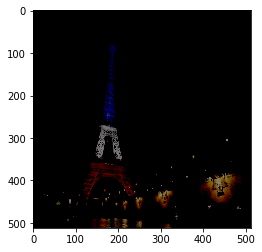

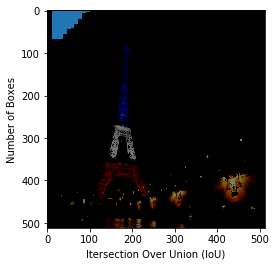

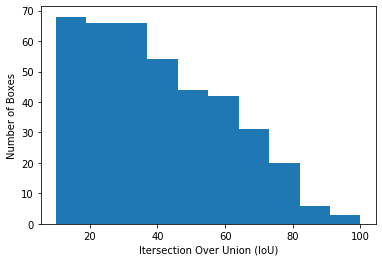

In [119]:
index = 123    # Change the image here
ans = []
for i in range(10):
    ans.append(Class_IOU(processed_ims2[i],  gt_cord_arr2[i],  gt_label_list2[i]))